In [1]:
#Importing Libraries

import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import calendar

In [2]:
#Loading dataset
fpath = 'C:\\Users\\Owner\\OneDrive - Sify Technologies Limited\\Desktop\\Dataset\\Train_Beneficiarydata-1542865627584.csv'
df_bene = pd.read_csv(fpath)

fpath = 'C:\\Users\\Owner\\OneDrive - Sify Technologies Limited\\Desktop\\Dataset\\Train_Inpatientdata-1542865627584.csv'
df_in_pt = pd.read_csv(fpath)

fpath = 'C:\\Users\\Owner\\OneDrive - Sify Technologies Limited\\Desktop\\Dataset\\Train_Outpatientdata-1542865627584.csv'
df_out_pt = pd.read_csv(fpath)

fpath = 'C:\\Users\\Owner\\OneDrive - Sify Technologies Limited\\Desktop\\Dataset\\Train-1542865627584.csv'
df_provider = pd.read_csv(fpath)

In [3]:
#First few rows of benificiary table

df_bene.head()

,BeneID,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,1/1/1943,NaN,1,1,0,39,230,12,12,1,2,1,2,2,1,1,1,2,1,1,36000,3204,60,70
1,BENE11002,9/1/1936,NaN,2,1,0,39,280,12,12,2,2,2,2,2,2,2,2,2,2,2,0,0,30,50
2,BENE11003,8/1/1936,NaN,1,1,0,52,590,12,12,1,2,2,2,2,2,2,1,2,2,2,0,0,90,40
3,BENE11004,7/1/1922,NaN,1,1,0,39,270,12,12,1,1,2,2,2,2,1,1,1,1,2,0,0,1810,760
4,BENE11005,9/1/1935,NaN,1,1,0,24,680,12,12,2,2,2,2,1,2,1,2,2,2,2,0,0,1790,1200


In [4]:
#Viewing few rows of Inpatient table

df_in_pt.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,ClmAdmitDiagnosisCode,DeductibleAmtPaid,DischargeDt,DiagnosisGroupCode,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6
0,BENE11001,CLM46614,4/12/2009,4/18/2009,PRV55912,26000,PHY390922,NaN,NaN,4/12/2009,7866,1068.0,4/18/2009,201,1970,4019,5853,7843,2768,71590,2724,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BENE11001,CLM66048,8/31/2009,9/2/2009,PRV55907,5000,PHY318495,PHY318495,NaN,8/31/2009,6186,1068.0,9/2/2009,750,6186,2948,56400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7092.0,NaN,NaN,NaN,NaN,NaN
2,BENE11001,CLM68358,9/17/2009,9/20/2009,PRV56046,5000,PHY372395,NaN,PHY324689,9/17/2009,29590,1068.0,9/20/2009,883,29623,30390,71690,34590,V1581,32723,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,BENE11011,CLM38412,2/14/2009,2/22/2009,PRV52405,5000,PHY369659,PHY392961,PHY349768,2/14/2009,431,1068.0,2/22/2009,67,43491,2762,7843,32723,V1041,4254,25062,40390,4019,NaN,331.0,NaN,NaN,NaN,NaN,NaN
4,BENE11014,CLM63689,8/13/2009,8/30/2009,PRV56614,10000,PHY379376,PHY398258,NaN,8/13/2009,78321,1068.0,8/30/2009,975,42,3051,34400,5856,42732,486,5119,29620,20300,NaN,3893.0,NaN,NaN,NaN,NaN,NaN


In [5]:
#First few rows of outpatient dataset

df_out_pt.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,DeductibleAmtPaid,ClmAdmitDiagnosisCode
0,BENE11002,CLM624349,10/11/2009,10/11/2009,PRV56011,30,PHY326117,NaN,NaN,78943,V5866,V1272,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,56409
1,BENE11003,CLM189947,2/12/2009,2/12/2009,PRV57610,80,PHY362868,NaN,NaN,6115,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,79380
2,BENE11003,CLM438021,6/27/2009,6/27/2009,PRV57595,10,PHY328821,NaN,NaN,2723,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
3,BENE11004,CLM121801,1/6/2009,1/6/2009,PRV56011,40,PHY334319,NaN,NaN,71988,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
4,BENE11004,CLM150998,1/22/2009,1/22/2009,PRV56011,200,PHY403831,NaN,NaN,82382,30000,72887,4280,7197,V4577,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,71947


In [6]:
#First few rows of provider dataset

df_provider.head()

,Provider,PotentialFraud
0,PRV51001,No
1,PRV51003,Yes
2,PRV51004,No
3,PRV51005,Yes
4,PRV51007,No


In [7]:
#Number of rows and columns in all dataset

print(df_bene.shape)
print(df_in_pt.shape)
print(df_out_pt.shape)
print(df_provider.shape)

(138556, 25)
(40474, 30)
(517737, 27)
(5410, 2)


In [8]:
#Basic info about beneficiary dataset

df_bene.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138556 entries, 0 to 138555
Data columns (total 25 columns):
 #   Column                           Non-Null Count   Dtype 
---  ------                           --------------   ----- 
 0   BeneID                           138556 non-null  object
 1   DOB                              138556 non-null  object
 2   DOD                              1421 non-null    object
 3   Gender                           138556 non-null  int64 
 4   Race                             138556 non-null  int64 
 5   RenalDiseaseIndicator            138556 non-null  object
 6   State                            138556 non-null  int64 
 7   County                           138556 non-null  int64 
 8   NoOfMonths_PartACov              138556 non-null  int64 
 9   NoOfMonths_PartBCov              138556 non-null  int64 
 10  ChronicCond_Alzheimer            138556 non-null  int64 
 11  ChronicCond_Heartfailure         138556 non-null  int64 
 12  ChronicCond_Kidn

In [9]:
#Basic info about inpatient dataset

df_in_pt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40474 entries, 0 to 40473
Data columns (total 30 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   BeneID                  40474 non-null  object 
 1   ClaimID                 40474 non-null  object 
 2   ClaimStartDt            40474 non-null  object 
 3   ClaimEndDt              40474 non-null  object 
 4   Provider                40474 non-null  object 
 5   InscClaimAmtReimbursed  40474 non-null  int64  
 6   AttendingPhysician      40362 non-null  object 
 7   OperatingPhysician      23830 non-null  object 
 8   OtherPhysician          4690 non-null   object 
 9   AdmissionDt             40474 non-null  object 
 10  ClmAdmitDiagnosisCode   40474 non-null  object 
 11  DeductibleAmtPaid       39575 non-null  float64
 12  DischargeDt             40474 non-null  object 
 13  DiagnosisGroupCode      40474 non-null  object 
 14  ClmDiagnosisCode_1      40474 non-null

In [10]:
#Basic info about out-patient dataset

df_out_pt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 517737 entries, 0 to 517736
Data columns (total 27 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   BeneID                  517737 non-null  object 
 1   ClaimID                 517737 non-null  object 
 2   ClaimStartDt            517737 non-null  object 
 3   ClaimEndDt              517737 non-null  object 
 4   Provider                517737 non-null  object 
 5   InscClaimAmtReimbursed  517737 non-null  int64  
 6   AttendingPhysician      516341 non-null  object 
 7   OperatingPhysician      90617 non-null   object 
 8   OtherPhysician          195046 non-null  object 
 9   ClmDiagnosisCode_1      507284 non-null  object 
 10  ClmDiagnosisCode_2      322357 non-null  object 
 11  ClmDiagnosisCode_3      203257 non-null  object 
 12  ClmDiagnosisCode_4      125596 non-null  object 
 13  ClmDiagnosisCode_5      74344 non-null   object 
 14  ClmDiagnosisCode_6  

In [11]:
#Providers info

df_provider.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5410 entries, 0 to 5409
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Provider        5410 non-null   object
 1   PotentialFraud  5410 non-null   object
dtypes: object(2)
memory usage: 84.7+ KB


# Data Cleaning

In [12]:
#Changing the type of column from str to datetime

df_bene['DOB'] = pd.to_datetime(df_bene['DOB'])
df_bene['DOD'] = pd.to_datetime(df_bene['DOD'])

In [13]:
df_in_pt['in_patient'] = 1
df_out_pt['in_patient'] = 0

In [14]:
#Missing values in benificiary dataset

df_bene.isnull().sum()

BeneID                                  0
DOB                                     0
DOD                                137135
Gender                                  0
Race                                    0
RenalDiseaseIndicator                   0
State                                   0
County                                  0
NoOfMonths_PartACov                     0
NoOfMonths_PartBCov                     0
ChronicCond_Alzheimer                   0
ChronicCond_Heartfailure                0
ChronicCond_KidneyDisease               0
ChronicCond_Cancer                      0
ChronicCond_ObstrPulmonary              0
ChronicCond_Depression                  0
ChronicCond_Diabetes                    0
ChronicCond_IschemicHeart               0
ChronicCond_Osteoporasis                0
ChronicCond_rheumatoidarthritis         0
ChronicCond_stroke                      0
IPAnnualReimbursementAmt                0
IPAnnualDeductibleAmt                   0
OPAnnualReimbursementAmt          

In [15]:
#missing values in providers dataset

df_provider.isnull().sum()

Provider          0
PotentialFraud    0
dtype: int64

In [16]:
#missing values in inpatient dataset

missing_val = df_in_pt.isnull()\
                      .sum()\
                      .sort_values(ascending=False)
missing_val

ClmProcedureCode_6        40474
ClmProcedureCode_5        40465
ClmProcedureCode_4        40358
ClmProcedureCode_3        39509
ClmDiagnosisCode_10       36547
OtherPhysician            35784
ClmProcedureCode_2        35020
ClmProcedureCode_1        17326
OperatingPhysician        16644
ClmDiagnosisCode_9        13497
ClmDiagnosisCode_8         9942
ClmDiagnosisCode_7         7258
ClmDiagnosisCode_6         4838
ClmDiagnosisCode_5         2894
ClmDiagnosisCode_4         1534
DeductibleAmtPaid           899
ClmDiagnosisCode_3          676
ClmDiagnosisCode_2          226
AttendingPhysician          112
ClaimID                       0
ClaimStartDt                  0
ClaimEndDt                    0
Provider                      0
InscClaimAmtReimbursed        0
in_patient                    0
AdmissionDt                   0
ClmAdmitDiagnosisCode         0
DischargeDt                   0
DiagnosisGroupCode            0
ClmDiagnosisCode_1            0
BeneID                        0
dtype: i

In [17]:
#percentage of missing values in inpatient dataset

missing_pct = missing_val[missing_val != 0]/len(df_in_pt) * 100
missing_pct

ClmProcedureCode_6     100.000000
ClmProcedureCode_5      99.977764
ClmProcedureCode_4      99.713396
ClmProcedureCode_3      97.615753
ClmDiagnosisCode_10     90.297475
OtherPhysician          88.412314
ClmProcedureCode_2      86.524683
ClmProcedureCode_1      42.807728
OperatingPhysician      41.122696
ClmDiagnosisCode_9      33.347334
ClmDiagnosisCode_8      24.563918
ClmDiagnosisCode_7      17.932500
ClmDiagnosisCode_6      11.953353
ClmDiagnosisCode_5       7.150269
ClmDiagnosisCode_4       3.790087
DeductibleAmtPaid        2.221179
ClmDiagnosisCode_3       1.670208
ClmDiagnosisCode_2       0.558383
AttendingPhysician       0.276721
dtype: float64

In [18]:
#Filling missing value with mean

df_in_pt['DeductibleAmtPaid'] = df_in_pt['DeductibleAmtPaid']\
                                .fillna(value = df_in_pt['DeductibleAmtPaid'].mean())

In [19]:
#Changing type from string to integer

df_in_pt['DeductibleAmtPaid'] = df_in_pt['DeductibleAmtPaid'].apply(np.int64)

In [20]:
#Finding missing value in out patient dataset

missing_val = df_out_pt.isnull()\
                      .sum()\
                      .sort_values(ascending=False)
missing_val

ClmProcedureCode_6        517737
ClmProcedureCode_5        517737
ClmProcedureCode_4        517735
ClmProcedureCode_3        517733
ClmProcedureCode_2        517701
ClmProcedureCode_1        517575
ClmDiagnosisCode_10       516654
ClmDiagnosisCode_9        502899
ClmDiagnosisCode_8        494825
ClmDiagnosisCode_7        484776
ClmDiagnosisCode_6        468981
ClmDiagnosisCode_5        443393
OperatingPhysician        427120
ClmAdmitDiagnosisCode     412312
ClmDiagnosisCode_4        392141
OtherPhysician            322691
ClmDiagnosisCode_3        314480
ClmDiagnosisCode_2        195380
ClmDiagnosisCode_1         10453
AttendingPhysician          1396
ClaimEndDt                     0
ClaimID                        0
ClaimStartDt                   0
in_patient                     0
Provider                       0
InscClaimAmtReimbursed         0
DeductibleAmtPaid              0
BeneID                         0
dtype: int64

In [21]:
#percentage of missing values in outpatient dataset

missing_pct = missing_val[missing_val != 0]/len(df_out_pt) * 100
missing_pct

ClmProcedureCode_6       100.000000
ClmProcedureCode_5       100.000000
ClmProcedureCode_4        99.999614
ClmProcedureCode_3        99.999227
ClmProcedureCode_2        99.993047
ClmProcedureCode_1        99.968710
ClmDiagnosisCode_10       99.790820
ClmDiagnosisCode_9        97.134066
ClmDiagnosisCode_8        95.574587
ClmDiagnosisCode_7        93.633640
ClmDiagnosisCode_6        90.582864
ClmDiagnosisCode_5        85.640586
OperatingPhysician        82.497484
ClmAdmitDiagnosisCode     79.637345
ClmDiagnosisCode_4        75.741351
OtherPhysician            62.327205
ClmDiagnosisCode_3        60.741264
ClmDiagnosisCode_2        37.737307
ClmDiagnosisCode_1         2.018979
AttendingPhysician         0.269635
dtype: float64

In [22]:
#Filling missing values

#df_out_pt['ClmDiagnosisCode_2'] = df_out_pt.fillna(df_out_pt['ClmDiagnosisCode_2'].mode())
#df_out_pt['ClmDiagnosisCode_1'] = df_out_pt.fillna(df_out_pt['ClmDiagnosisCode_1'].mode())
#df_out_pt['AttendingPhysician'] = df_out_pt.fillna(df_out_pt['AttendingPhysician'].mode())

In [23]:
#df_out_pt = df_out_pt.drop(['ClmProcedureCode_6', 'ClmProcedureCode_5', 'ClmProcedureCode_4',
                         # 'ClmProcedureCode_3', 'ClmDiagnosisCode_10', 'OtherPhysician',
                         # 'ClmProcedureCode_2'], axis = 1)

# Merging Tables

In [24]:
#Merging Inpatient and outpatient table 

in_out_pt=pd.merge(df_out_pt, df_in_pt,
                              left_on=['BeneID', 'ClaimID', 'ClaimStartDt', 'ClaimEndDt', 'Provider',
       'InscClaimAmtReimbursed', 'AttendingPhysician', 'OperatingPhysician',
       'ClmDiagnosisCode_1', 'ClmDiagnosisCode_2', 'OtherPhysician',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmProcedureCode_1', 'ClmProcedureCode_2',
       'ClmProcedureCode_3', 'ClmProcedureCode_4', 'ClmProcedureCode_5',
       'ClmProcedureCode_6',                               
       'DeductibleAmtPaid', 'in_patient',
       'ClmAdmitDiagnosisCode'],
                              right_on=['BeneID', 'ClaimID', 'ClaimStartDt', 'ClaimEndDt', 'Provider',
       'InscClaimAmtReimbursed', 'AttendingPhysician', 'OperatingPhysician',
       'ClmDiagnosisCode_1', 'ClmDiagnosisCode_2', 'OtherPhysician',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmProcedureCode_1', 'ClmProcedureCode_2',
       'ClmProcedureCode_3', 'ClmProcedureCode_4',
                    'ClmProcedureCode_5', 'ClmProcedureCode_6',                    
       'DeductibleAmtPaid', 'in_patient',
       'ClmAdmitDiagnosisCode']
                              ,how='outer')

In [25]:
#Merging In_out_patient table with Beneficiary table

merged_df = pd.merge(in_out_pt, df_bene, left_on='BeneID', right_on='BeneID', how='inner')

In [26]:
#Merging the table to providers table

final_df =pd.merge(df_provider, merged_df, on='Provider')

In [27]:
#Creating age column

final_df['DOB'] = pd.to_datetime(final_df['DOB'] , format = '%Y-%m-%d',errors='ignore')
final_df['DOD'] = pd.to_datetime(final_df['DOD'],format = '%Y-%m-%d',errors='ignore')
final_df['Age'] = round(((final_df['DOD'] - final_df['DOB']).dt.days)/365)
final_df.Age.fillna(round(((pd.to_datetime('2009-12-01' , format = '%Y-%m-%d') - final_df['DOB']).dt.days)/365),
                                 inplace=True)

In [28]:
final_df['AdmissionDt'] = pd.to_datetime(final_df['AdmissionDt'])
final_df['DischargeDt'] = pd.to_datetime(final_df['DischargeDt'])
                                         

In [29]:
final_df['AdmissionDt'] = pd.to_datetime(final_df['AdmissionDt'] , format = '%m-%d-%Y')
final_df['DischargeDt'] = pd.to_datetime(final_df['DischargeDt'],format = '%m-%d-%Y')
final_df['DaysAdmitted'] = ((final_df['DischargeDt'] - final_df['AdmissionDt']).dt.days)+1

In [30]:
final_df['DaysAdmitted'] = final_df['DaysAdmitted'].fillna(0)

In [31]:
#Creating column patients Alive 
final_df.loc[final_df.DOD.isna(),'Alive']=0
final_df.loc[final_df.DOD.notna(),'Alive']=1

In [32]:
final_df.head(3)

,Provider,PotentialFraud,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10_x,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,DeductibleAmtPaid,ClmAdmitDiagnosisCode,in_patient,AdmissionDt,DischargeDt,DiagnosisGroupCode,ClmDiagnosisCode_10_y,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,DaysAdmitted,Alive
0,PRV51001,No,BENE11727,CLM733300,12/17/2009,12/17/2009,20,PHY383007,NaN,PHY383007,5953,42731,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaT,NaT,NaN,NaN,1930-05-01,NaT,1,1,Y,1,660,12,12,1,1,1,1,2,2,1,1,2,2,2,0,0,300,110,80.0,0.0,0.0
1,PRV51001,No,BENE24646,CLM372475,5/22/2009,5/23/2009,700,PHY405682,NaN,PHY402512,78650,51889,V5869,4019,V4581,49320,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaT,NaT,NaN,NaN,1943-03-01,NaT,1,1,0,1,440,12,12,1,2,2,2,2,2,1,1,1,2,1,0,0,720,10,67.0,0.0,0.0
2,PRV51001,No,BENE31617,CLM748221,12/28/2009,12/28/2009,900,PHY345302,NaN,NaN,V446,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,59970,0,NaT,NaT,NaN,NaN,1933-08-01,NaT,2,1,0,1,660,12,12,2,2,1,2,2,2,1,1,2,1,2,0,0,1380,370,76.0,0.0,0.0


In [33]:
final_df.isnull().sum()

Provider                                0
PotentialFraud                          0
BeneID                                  0
ClaimID                                 0
ClaimStartDt                            0
ClaimEndDt                              0
InscClaimAmtReimbursed                  0
AttendingPhysician                   1508
OperatingPhysician                 443764
OtherPhysician                     358475
ClmDiagnosisCode_1                  10453
ClmDiagnosisCode_2                 195606
ClmDiagnosisCode_3                 315156
ClmDiagnosisCode_4                 393675
ClmDiagnosisCode_5                 446287
ClmDiagnosisCode_6                 473819
ClmDiagnosisCode_7                 492034
ClmDiagnosisCode_8                 504767
ClmDiagnosisCode_9                 516396
ClmDiagnosisCode_10_x              557128
ClmProcedureCode_1                 534901
ClmProcedureCode_2                 552721
ClmProcedureCode_3                 557242
ClmProcedureCode_4                

In [34]:
final_df.describe()

,InscClaimAmtReimbursed,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,DeductibleAmtPaid,in_patient,Gender,Race,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,DaysAdmitted,Alive
count,558211.000000,23310.000000,5490.000000,969.000000,118.000000,9.000000,0.0,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.00000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000,558211.000000
mean,997.012133,5896.154612,4106.358106,4221.123839,4070.262712,5269.444444,NaN,80.014804,0.072507,1.578838,1.255011,25.446969,378.588195,11.931472,11.93877,1.598132,1.409573,1.587998,1.848615,1.687070,1.565193,1.294605,1.240735,1.682353,1.688829,1.898280,5227.971466,568.756807,2278.225348,649.698745,73.769770,0.483269,0.007400
std,3821.534891,3050.489933,2031.640878,2281.849885,2037.626990,2780.071632,NaN,276.656578,0.259325,0.493746,0.717437,15.192784,265.215531,0.889712,0.78590,0.490276,0.491755,0.492196,0.358424,0.463687,0.495732,0.455866,0.427530,0.465562,0.462973,0.302279,11786.274732,1179.172616,3881.846386,1002.020811,13.022524,2.300583,0.085707
min,0.000000,11.000000,42.000000,42.000000,42.000000,2724.000000,NaN,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,-8000.000000,0.000000,-70.000000,0.000000,26.000000,0.000000,0.000000
25%,40.000000,3848.000000,2724.000000,2724.000000,2754.250000,4139.000000,NaN,0.000000,0.000000,1.000000,1.000000,11.000000,150.000000,12.000000,12.00000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,0.000000,0.000000,460.000000,120.000000,68.000000,0.000000,0.000000
50%,80.000000,5363.000000,4019.000000,4019.000000,4019.000000,4139.000000,NaN,0.000000,0.000000,2.000000,1.000000,24.000000,350.000000,12.000000,12.00000,2.000000,1.000000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,2.000000,2.000000,2.000000,0.000000,0.000000,1170.000000,340.000000,75.000000,0.000000,0.000000
75%,300.000000,8669.000000,4439.000000,5185.000000,4439.000000,5185.000000,NaN,0.000000,0.000000,2.000000,1.000000,38.000000,570.000000,12.000000,12.00000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,2.000000,2.000000,2.000000,6000.000000,1068.000000,2590.000000,790.000000,82.000000,0.000000,0.000000
max,125000.000000,9999.000000,9999.000000,9999.000000,9986.000000,9982.000000,NaN,1068.000000,1.000000,2.000000,5.000000,54.000000,999.000000,12.000000,12.00000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,161470.000000,38272.000000,102960.000000,13840.000000,101.000000,36.000000,1.000000


# Data Visualization

In [35]:
#Calculating percentage of potential fraud

fraud_count = final_df['PotentialFraud'].value_counts(normalize = True)\
                                        .reset_index(name='fraction')\
                                        .rename(columns={'index':'potential_fraud'})
fraud_count

,potential_fraud,fraction
0,No,0.618789
1,Yes,0.381211


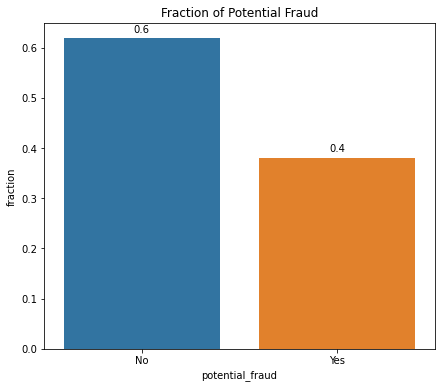

In [104]:
#Visualizing potential fraud

plt.figure(figsize =(7,6))
chart = sns.barplot(x='potential_fraud', y='fraction', data=fraud_count)

for p in chart.patches:
    chart.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va = 'center', 
                   xytext=(0, 9), 
                   textcoords='offset points')
plt.title('Fraction of Potential Fraud')
plt.savefig('Fraction of Potential Fraud.png')
plt.show()

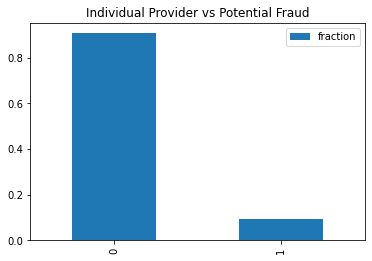

In [103]:
#Visualizing fraud percentage before merging data

df_provider['PotentialFraud'].value_counts(normalize = True)\
                                        .reset_index(name='fraction')\
                                        .rename(columns={'index':'potential_fraud'})\
                                         .plot(kind = 'bar', 
                                               title='Individual Provider vs Potential Fraud'
                                              )
plt.savefig('Potential fraud with providers.png')
plt.show()

In [38]:
#Calculting the total count of genders

gender = final_df.groupby('Gender')['PotentialFraud'].value_counts(normalize=True)\
                     .reset_index(name='fraction')\
                     .rename(columns={'index':'gender'})
gender

,Gender,PotentialFraud,fraction
0,1,No,0.618528
1,1,Yes,0.381472
2,2,No,0.618980
3,2,Yes,0.381020


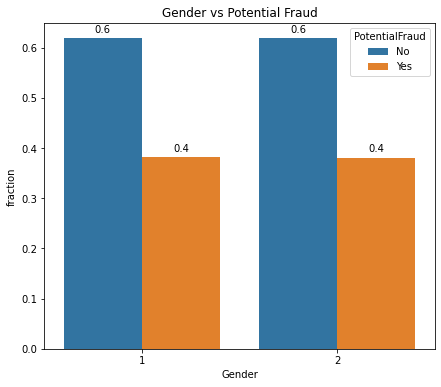

In [106]:
#Visualizing gender count

plt.figure(figsize = (7,6))
g = sns.barplot(x='Gender', y='fraction', data = gender, hue = 'PotentialFraud')

for p in g.patches:
    g.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), 
                   textcoords = 'offset points')
plt.title('Gender vs Potential Fraud')
plt.savefig('Gender vs Fraud.png')
plt.show()

In [40]:
#Calculating by race

race_count = final_df.groupby('Race')['PotentialFraud']\
                     .value_counts(normalize=True)\
                     .reset_index(name='fraction')\
                     .rename(columns={'index':'Race'})
race_count

,Race,PotentialFraud,fraction
0,1,No,0.621377
1,1,Yes,0.378623
2,2,No,0.635442
3,2,Yes,0.364558
4,3,No,0.545422
5,3,Yes,0.454578
6,5,No,0.559645
7,5,Yes,0.440355


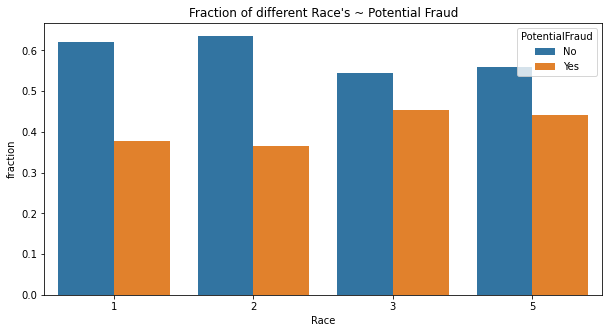

In [107]:
#Visualizing the distribution of race
plt.figure(figsize=(10,5))
plt.figure
sns.barplot(x='Race', y='fraction', data=race_count, hue='PotentialFraud')
plt.title("Fraction of different Race's ~ Potential Fraud")
plt.savefig('Race vs Fraud.png')
plt.show()

In [110]:
#Visualizing the distribution of age

age = px.histogram(final_df, 
                   x = 'Age',
                   color='PotentialFraud',
                   title = 'Distribution of Age ~ Potential Fraud', 
                   text_auto ='.2s',
                   barmode='overlay')
age.show()

In [109]:
#Age wise vs potential fraud vs patient type

age_inpatient = px.histogram(final_df, 
                   x = 'Age',
                   color='PotentialFraud',
                   title = 'Potential Fraud based on Age and Patient Type', 
                   facet_row='in_patient',
                   text_auto ='.2s',
                   barmode='overlay')

import re
for k in age_inpatient.layout:
    if re.search('yaxis[1-9]+', k):
        age_inpatient.layout[k].update(matches=None)
        
age_inpatient.show()

In [44]:
#Calculating number of physician for each patient and potential fraud

patient_physician_count = final_df.groupby(['BeneID','PotentialFraud'])['AttendingPhysician']\
        .nunique()\
        .reset_index(name='count')\
        .nlargest(10,'count')                                   
patient_physician_count

,BeneID,PotentialFraud,count
121167,BENE42721,No,25
180584,BENE87248,No,22
31072,BENE122118,No,20
76123,BENE152793,No,20
7452,BENE105559,No,19
15284,BENE111306,Yes,19
141847,BENE58228,No,19
172199,BENE80977,Yes,19
173477,BENE81944,Yes,19
38324,BENE127027,No,18


In [108]:
#Visualizing patients vs number of physicians 

phys_patient = px.bar(patient_physician_count, 
                   y ='BeneID',
                   x='count',
                   color='PotentialFraud',
                   title='Patient with Multiple Physician vs Potential Fraud', 
                   text_auto ='.2s'
                   )
phys_patient.show()

In [46]:
#State with patients vs fraud

state_distribution = final_df.groupby('State')['PotentialFraud'].value_counts()\
                                      .reset_index(name='count')\
                                      .rename(columns={'index':'state'})\
                                      .nlargest(10,'count')
state_distribution = state_distribution.sort_values(by='count', ascending=False)
state_distribution

,State,PotentialFraud,count
8,5,Yes,30335
86,45,No,23887
18,10,No,21561
9,5,No,21015
64,33,No,17532
19,10,Yes,17512
65,33,Yes,17492
26,14,No,15908
70,36,No,14910
66,34,No,14520


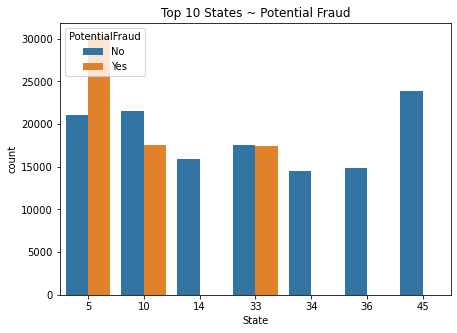

In [105]:
#Visualizing top 10 states with potential fraud

plt.figure(figsize=(7,5))
sns.barplot(
    x='State', 
    y='count', 
    hue='PotentialFraud',
    data=state_distribution.sort_values(
        by='count'
    )
    
)
plt.title('Top 10 States ~ Potential Fraud')    
plt.savefig('State.png')
plt.show()

In [48]:
#Subsetting with state 5
state_df = final_df[final_df['State']==5]
state_df.head(3)

,Provider,PotentialFraud,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10_x,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,DeductibleAmtPaid,ClmAdmitDiagnosisCode,in_patient,AdmissionDt,DischargeDt,DiagnosisGroupCode,ClmDiagnosisCode_10_y,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,DaysAdmitted,Alive
1798,PRV51017,No,BENE16968,CLM166737,1/30/2009,1/30/2009,100,PHY401044,PHY399403,NaN,V6546,V7284,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaT,NaT,NaN,NaN,1940-12-01,NaT,2,1,0,5,200,12,12,1,1,2,2,1,2,1,1,2,1,1,9240,1068,1350,980,69.0,0.0,0.0
2083,PRV51017,No,BENE100520,CLM625705,10/11/2009,10/11/2009,400,PHY413781,NaN,NaN,73300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaT,NaT,NaN,NaN,1922-01-01,NaT,2,5,0,5,200,12,12,2,2,2,2,2,2,2,1,1,2,2,0,0,1630,200,88.0,0.0,0.0
4376,PRV51042,No,BENE51499,CLM192912,2/13/2009,2/13/2009,300,PHY336437,NaN,NaN,78650,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaT,NaT,NaN,NaN,1943-07-01,NaT,2,1,Y,5,200,12,12,2,2,2,2,1,1,2,1,2,2,2,23240,4272,300,60,66.0,0.0,0.0


In [49]:
#Calculating top 10 patients vs potential fraud in state 5

age_inpatient_fraud = state_df.groupby(['Age', 'in_patient'])['PotentialFraud']\
        .value_counts(normalize=True)\
        .reset_index(name='fraction')\
        .nlargest(10, 'fraction')

age_inpatient_fraud      

,Age,in_patient,PotentialFraud,fraction
8,28.0,1,Yes,1.000000
39,36.0,1,No,1.000000
102,52.0,1,Yes,1.000000
66,43.0,1,Yes,0.875000
6,28.0,0,Yes,0.839286
31,34.0,1,Yes,0.800000
42,37.0,1,Yes,0.800000
58,41.0,1,Yes,0.800000
62,42.0,1,Yes,0.800000
94,50.0,1,Yes,0.750000


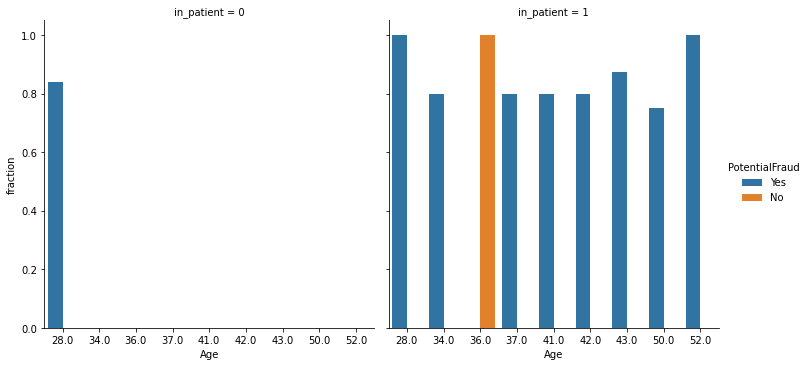

In [89]:
#Age vs inpatient vs potential fraud in state 5

sns.catplot(
    x='Age', 
    y='fraction', 
    data=age_inpatient_fraud, 
    kind='bar', hue='PotentialFraud', 
    col='in_patient')
plt.savefig('State ~ Age ~ Fraud.png')
plt.show()

In [51]:
#Calculating top ten physicians vs potential fraud

physician_count = final_df.groupby('AttendingPhysician')['PotentialFraud']\
                          .value_counts(normalize=True)\
                          .reset_index(name='fraction')\
                          .rename(columns={'index':'physician'}).nlargest(10,'fraction')
physician_count

,AttendingPhysician,PotentialFraud,fraction
0,PHY311001,No,1.0
1,PHY311002,Yes,1.0
2,PHY311004,No,1.0
3,PHY311005,No,1.0
4,PHY311006,No,1.0
7,PHY311010,No,1.0
8,PHY311011,Yes,1.0
9,PHY311012,No,1.0
10,PHY311013,No,1.0
11,PHY311014,No,1.0


In [111]:
#Top 10 Physicians vs potential fraud

fig = px.bar(physician_count, x='AttendingPhysician', y='fraction', text_auto=True, title='Top 10 Physician ~ Potential Fraud', color='PotentialFraud')
fig.show()

In [53]:
#Calculating top 10 providers vs fraud

provider_count = final_df.groupby('Provider')['PotentialFraud']\
                          .value_counts(normalize=True)\
                          .reset_index(name='fraction')\
                          .rename(columns={'index':'provider'})\
                          .nlargest(10,'fraction')
provider_count

,Provider,PotentialFraud,fraction
0,PRV51001,No,1.0
1,PRV51003,Yes,1.0
2,PRV51004,No,1.0
3,PRV51005,Yes,1.0
4,PRV51007,No,1.0
5,PRV51008,No,1.0
6,PRV51011,No,1.0
7,PRV51012,No,1.0
8,PRV51013,No,1.0
9,PRV51014,No,1.0


In [112]:
#Visualizing top 10 provider vs potential fraud

fig = px.bar(provider_count, x='Provider', y='fraction', text_auto=True, title='Top 10 Providers ~ Potential Fraud', color='PotentialFraud')
fig.show()

In [55]:
#Calculating top 10 Physician in association provider

physician_provider_count = final_df.groupby(['AttendingPhysician','PotentialFraud'])['Provider']\
                                  .nunique()\
                                  .reset_index(name='count')\
                                  .nlargest(10,'count')                                   
physician_provider_count     

,AttendingPhysician,PotentialFraud,count
21199,PHY342165,No,9
36710,PHY365132,No,8
72090,PHY417254,No,7
7900,PHY322656,No,6
9450,PHY324903,No,6
14478,PHY332314,No,6
20230,PHY340715,No,6
23920,PHY346134,No,6
61259,PHY401319,No,6
72951,PHY418551,No,6


In [114]:
#Visualizing top 10 Physician in association provider

physician_provider = px.bar(physician_provider_count, 
                   y ='AttendingPhysician',
                   x='count',
                   color='PotentialFraud',
                   title='Top 10 Physician vs Multiple Provider', 
                   text_auto ='.2s'
                   )
physician_provider.show()

In [57]:
#Calculating bottom 10 Physician in association provider

physician_provider_count_s = final_df.groupby(['AttendingPhysician','PotentialFraud'])['Provider']\
                                  .nunique()\
                                  .reset_index(name='count')\
                                  .nsmallest(10,'count')                                   
physician_provider_count_s

,AttendingPhysician,PotentialFraud,count
0,PHY311001,No,1
1,PHY311002,Yes,1
2,PHY311004,No,1
3,PHY311005,No,1
4,PHY311006,No,1
5,PHY311008,No,1
6,PHY311008,Yes,1
7,PHY311010,No,1
8,PHY311011,Yes,1
9,PHY311012,No,1


In [115]:
#Visualizing bottom 10 Physician in association provider

physician_provider_s = px.bar(physician_provider_count_s, 
                   y ='AttendingPhysician',
                   x='count',
                   color='PotentialFraud',
                   title='Physician associated Least number of Provider', 
                   text_auto ='.2s'
                   )
physician_provider_s.show()

In [59]:
claim_diag_code = final_df['ClmAdmitDiagnosisCode'].value_counts()\
                                                   .reset_index(name='code_count')\
                                                   .rename(columns={'index':'ClmAdmitDiagnosisCode'})\
                                                   .nlargest(10,'code_count')
                                 
                                 
claim_diag_code                                

,ClmAdmitDiagnosisCode,code_count
0,V7612,4074
1,42731,3634
2,78605,2992
3,4019,2732
4,25000,2368
5,78900,2336
6,78650,2273
7,V5883,1873
8,7295,1844
9,78079,1779


In [90]:
fig = px.bar(claim_diag_code, 
             x='ClmAdmitDiagnosisCode', 
             y='code_count', 
             title='Top ten Claim Diagnostic Code at the time of Admit')
fig.show()

In [61]:
claim_phys_count = final_df.groupby(['AttendingPhysician', 'ClmAdmitDiagnosisCode'])['PotentialFraud']\
                          .value_counts()\
                          .reset_index(name='count')\
                          .rename(columns={'index':'physician'}).nlargest(10,'count')
claim_phys_count

,AttendingPhysician,ClmAdmitDiagnosisCode,PotentialFraud,count
21058,PHY330576,V7612,Yes,22
20876,PHY330576,42731,Yes,19
119914,PHY422134,486,Yes,18
119986,PHY422134,78650,Yes,18
119983,PHY422134,78605,Yes,17
3195,PHY314027,V7612,Yes,14
20979,PHY330576,7862,Yes,13
33410,PHY341560,78650,Yes,13
43585,PHY350277,42731,Yes,13
20822,PHY330576,25000,Yes,12


In [116]:
fig = px.bar(claim_phys_count, 
             x='ClmAdmitDiagnosisCode', 
             y='count',
             color='AttendingPhysician',
             title='Physician with Potential Frauad ~ Claim Diagnostic Code at the time of Admit')
fig.show()

In [63]:
claim_provider_count = final_df.groupby(['ClmAdmitDiagnosisCode','Provider'])['PotentialFraud']\
                              .value_counts()\
                              .reset_index(name='code_count')\
                              .rename(columns={'index':'ClmAdmitDiagnosisCode'})\
                              .nlargest(10,'code_count')
                                 
                                 
claim_provider_count  

,ClmAdmitDiagnosisCode,Provider,PotentialFraud,code_count
110333,V7612,PRV51459,Yes,61
29967,42731,PRV51459,Yes,48
24600,4019,PRV51459,Yes,45
110364,V7612,PRV51574,Yes,43
7365,25000,PRV51459,Yes,39
110880,V7612,PRV53797,Yes,36
30001,42731,PRV51574,Yes,33
106253,V5883,PRV51459,Yes,31
30075,42731,PRV52019,Yes,30
111144,V7612,PRV54895,Yes,30


In [117]:
fig = px.bar(claim_provider_count, 
             x='ClmAdmitDiagnosisCode', 
             y='code_count',
             color='Provider',
             title='Provider with Potential Fraud ~ Claim Diagnostic Code at the time of Admit')
fig.show()

In [65]:
#Creating temprorary table for chronic condition

temp_df = final_df[["ChronicCond_Alzheimer","ChronicCond_Heartfailure", "ChronicCond_KidneyDisease",
                    "ChronicCond_Cancer",
                    "ChronicCond_ObstrPulmonary", "ChronicCond_Depression", 
                    "ChronicCond_Diabetes", "ChronicCond_IschemicHeart",
                    "ChronicCond_Osteoporasis", "ChronicCond_rheumatoidarthritis",
                    "ChronicCond_stroke",'Age' ]]

In [66]:
#Chronic condition vs Age

age_chronic_cond_df = temp_df.melt(id_vars=["Age"], 
        var_name="chronic_condition", 
        value_name="Value")
age_chronic_cond_df.head()

,Age,chronic_condition,Value
0,80.0,ChronicCond_Alzheimer,1
1,67.0,ChronicCond_Alzheimer,1
2,76.0,ChronicCond_Alzheimer,2
3,74.0,ChronicCond_Alzheimer,1
4,69.0,ChronicCond_Alzheimer,2


In [67]:
#Binning age group

age_chronic_cond_df['age'] = pd.cut(age_chronic_cond_df['Age'], bins=[0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100],
                                                    labels=['0-10', '11-20','21-30','31-40', '41-50','51-60',
                        '61-70', '71-80', '81-90', '91-100'])
age_chronic_cond_df.head()

,Age,chronic_condition,Value,age
0,80.0,ChronicCond_Alzheimer,1,71-80
1,67.0,ChronicCond_Alzheimer,1,61-70
2,76.0,ChronicCond_Alzheimer,2,71-80
3,74.0,ChronicCond_Alzheimer,1,71-80
4,69.0,ChronicCond_Alzheimer,2,61-70


In [68]:
#Calculating the chronic condition based on age

age_chronic_count = age_chronic_cond_df.groupby(['age','chronic_condition'])['Value']\
                   .value_counts()\
                   .reset_index(name='count')\
                   .sort_values(by='count', ascending=False)\
                   #.nlargest(10,'count')\
                   #.plot(kind='bar',y ='chronic_condition', x='count', hue ='age', title='Chronic Condition ~ Age', figsize=(9,5))


age_chronic_count

,age,chronic_condition,Value,count
130,71-80,ChronicCond_stroke,2,174216
112,71-80,ChronicCond_Cancer,2,162854
120,71-80,ChronicCond_IschemicHeart,1,145786
116,71-80,ChronicCond_Diabetes,1,135089
124,71-80,ChronicCond_ObstrPulmonary,2,135069
...,...,...,...,...
15,21-30,ChronicCond_ObstrPulmonary,1,981
17,21-30,ChronicCond_Osteoporasis,1,971
19,21-30,ChronicCond_rheumatoidarthritis,1,929
21,21-30,ChronicCond_stroke,1,339


In [69]:
#Top 10 chronic condition based on age

chronic_condition = age_chronic_count.loc[age_chronic_count.Value == 1]\
                                     .nlargest(10,'count')\
                                     .reset_index(drop=True)
chronic_condition

,age,chronic_condition,Value,count
0,71-80,ChronicCond_IschemicHeart,1,145786
1,71-80,ChronicCond_Diabetes,1,135089
2,71-80,ChronicCond_Heartfailure,1,112194
3,81-90,ChronicCond_IschemicHeart,1,106007
4,81-90,ChronicCond_Diabetes,1,99107
5,61-70,ChronicCond_IschemicHeart,1,88594
6,81-90,ChronicCond_Heartfailure,1,84681
7,61-70,ChronicCond_Diabetes,1,80401
8,71-80,ChronicCond_Depression,1,80212
9,71-80,ChronicCond_KidneyDisease,1,77906


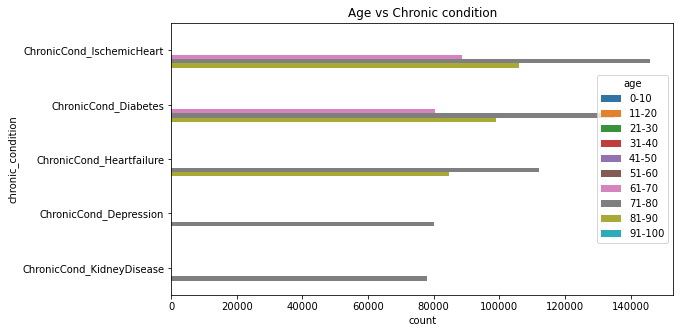

In [118]:
#Age ~ Chronic Condition

plt.figure(figsize=(9,5))
sns.barplot(y='chronic_condition', x='count', data=chronic_condition, hue='age')
plt.title('Age vs Chronic condition')
plt.savefig('Age ~ Chronic condition.png')
plt.show()

In [71]:
#Calculating potential fraud based on procedure code

df_procedure = pd.DataFrame(columns = ['procedure', 'PotentialFraud'])
df_procedure['procedure'] = pd.concat([final_df["ClmProcedureCode_1"], 
                                       final_df["ClmProcedureCode_2"], 
                                       final_df["ClmProcedureCode_3"], 
                                       final_df["ClmProcedureCode_4"], 
                                       final_df["ClmProcedureCode_5"], 
                                       final_df["ClmProcedureCode_6"]],
                                             axis=0, sort=True).dropna()
df_procedure['PotentialFraud'] = final_df['PotentialFraud']
                                          
grouped_procedure = df_procedure.groupby(['procedure'])['PotentialFraud'].value_counts()\
                                                         .reset_index(name='count')\
                                                         .rename(columns={'index':'procedure_code'})\
                                                         .nlargest(10,'count')
grouped_procedure

,procedure,PotentialFraud,count
696,4019.0,Yes,1139
697,4019.0,No,820
352,2724.0,Yes,641
2039,9904.0,Yes,634
1583,8154.0,Yes,615
32,66.0,Yes,539
2040,9904.0,No,518
629,3893.0,Yes,483
689,3995.0,Yes,477
353,2724.0,No,413


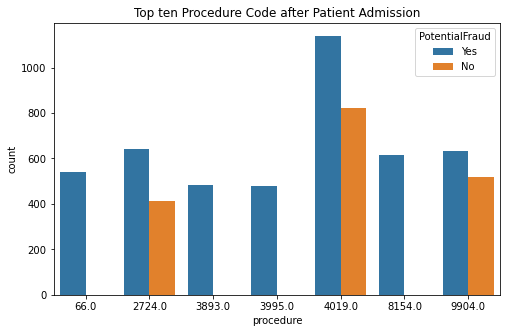

In [92]:
plt.figure(figsize=(8,5))
sns.barplot(x='procedure', y='count', data=grouped_procedure, hue='PotentialFraud')
plt.title('Top ten Procedure Code after Patient Admission')
plt.savefig('Procedure code vs fraud.png')
plt.show()

In [73]:
df_diagnosis = pd.DataFrame(columns = ['Diagnosis', 'PotentialFraud'])
df_diagnosis['Diagnosis'] = pd.concat([final_df["ClmDiagnosisCode_1"], 
                                       final_df["ClmDiagnosisCode_2"], 
                                       final_df["ClmDiagnosisCode_3"], 
                                       final_df["ClmDiagnosisCode_4"], 
                                       final_df["ClmDiagnosisCode_5"], 
                                       final_df["ClmDiagnosisCode_6"], 
                                       final_df["ClmDiagnosisCode_7"],  
                                       final_df["ClmDiagnosisCode_8"], 
                                       final_df["ClmDiagnosisCode_9"]
                                           ],
                                          axis=0, sort=True).dropna()

df_diagnosis['PotentialFraud'] = final_df['PotentialFraud']

grouped_diagnosis = df_diagnosis.groupby(['Diagnosis'])['PotentialFraud'].value_counts()\
                                                         .reset_index(name='count')\
                                                         .rename(columns={'index':'diag_code'})\
                                                         .nlargest(10,'count')
grouped_diagnosis

,Diagnosis,PotentialFraud,count
6608,4019,No,45930
6609,4019,Yes,30957
2263,25000,No,22201
2607,2724,No,21031
19256,V5869,No,15777
6606,4011,No,15118
2264,25000,Yes,15030
2608,2724,Yes,14632
19242,V5861,No,12362
6975,42731,No,11411


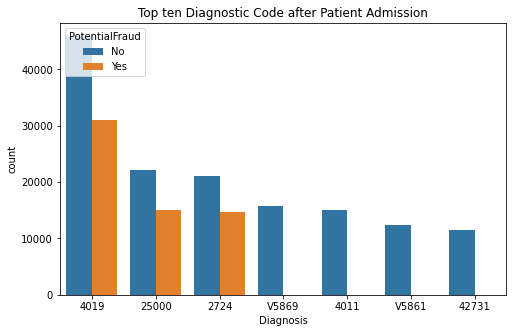

In [93]:
plt.figure(figsize=(8,5))
sns.barplot(x='Diagnosis', y='count', data=grouped_diagnosis, hue='PotentialFraud')
plt.title('Top ten Diagnostic Code after Patient Admission')
plt.savefig('diagnostic code vs fraud.png')
plt.show()

In [75]:
reimbursement = final_df.groupby(['InscClaimAmtReimbursed'])['PotentialFraud'].value_counts()\
                                                  .reset_index(name='reimburse_count')\
                                                  .rename(columns={'index':'InscClaimAmtReimbursed'})\
                                                  .nlargest(10, 'reimburse_count')
reimbursement

,InscClaimAmtReimbursed,PotentialFraud,reimburse_count
20,100,No,33492
2,10,No,26908
40,200,No,26531
12,60,No,25860
6,30,No,21515
8,40,No,21296
10,50,No,19950
21,100,Yes,19468
4,20,No,17748
16,80,No,15874


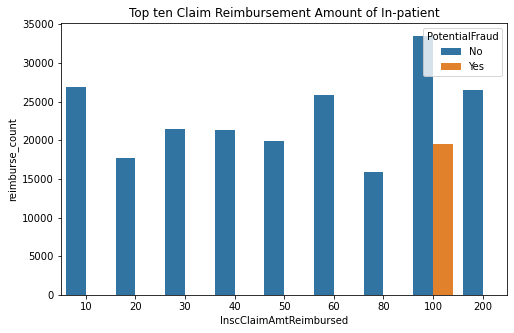

In [100]:
plt.figure(figsize=(8,5))
sns.barplot(x='InscClaimAmtReimbursed', y='reimburse_count', data=reimbursement, hue='PotentialFraud')
plt.title('Top ten Claim Reimbursement Amount of In-patient')
plt.savefig('Reimbursement vs fraud.png')
plt.show()

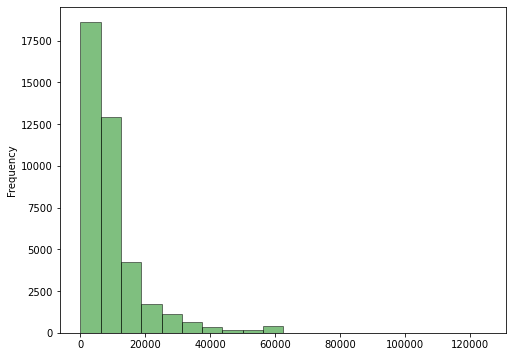

In [77]:
ax = df_in_pt['InscClaimAmtReimbursed'].plot.hist(bins=20, alpha=0.5, figsize=(8, 6), facecolor='g', edgecolor='k')

In [78]:
physician_beneficiary = final_df.groupby(['AttendingPhysician'])['BeneID'].nunique()\
                                                    .reset_index(name='count')\
                                                    .rename(columns={'index':'AttendingPhysician'})\
                                                    .nlargest(10, 'count')
physician_beneficiary

,AttendingPhysician,count
13066,PHY330576,1411
74942,PHY423534,958
1987,PHY314027,948
30737,PHY357120,938
10746,PHY327046,932
67342,PHY412132,929
18027,PHY338032,920
20417,PHY341578,898
17622,PHY337425,888
81061,PHY432650,843


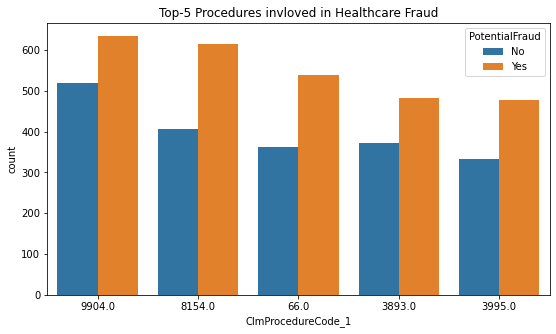

In [79]:
plt.figure(figsize=(9,5))
sns.countplot(x='ClmProcedureCode_1', hue = 'PotentialFraud',
              data=final_df, order=final_df.ClmProcedureCode_1.value_counts().iloc[:5].index)
plt.title('Top-5 Procedures invloved in Healthcare Fraud')
plt.savefig('Procedure.png')
plt.show()

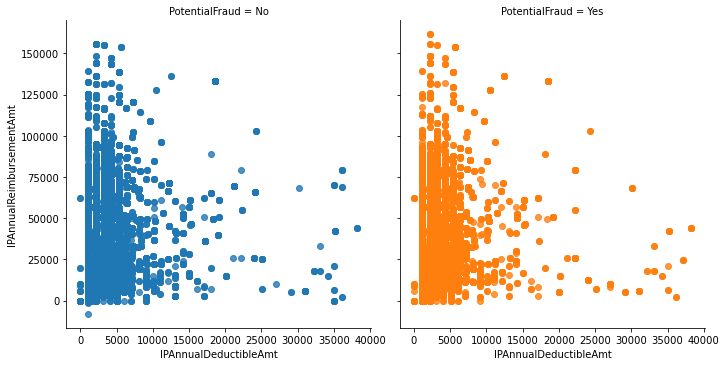

In [95]:
sns.lmplot(x='IPAnnualDeductibleAmt', y='IPAnnualReimbursementAmt', hue='PotentialFraud',
           col='PotentialFraud', fit_reg=False, data=final_df)
plt.savefig('Annual deductable amt vs Annual reimbursement.png')
plt.show()

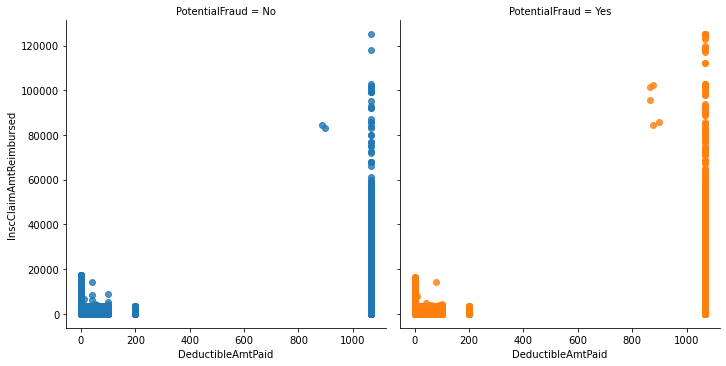

In [96]:
sns.lmplot(x='DeductibleAmtPaid',y='InscClaimAmtReimbursed',hue='PotentialFraud',
           col='PotentialFraud',fit_reg=False,data=final_df)
plt.savefig('Deductible amt vs Reimbursement.png')
plt.show()

In [82]:
provider_reimburse = final_df.groupby(['Provider', 'InscClaimAmtReimbursed'])['PotentialFraud'].value_counts()\
                                                                .reset_index(name='count')\
                                                                .nlargest(15,'InscClaimAmtReimbursed')
provider_reimburse

,Provider,InscClaimAmtReimbursed,PotentialFraud,count
28606,PRV52815,125000,Yes,1
37897,PRV53461,125000,Yes,1
55835,PRV54742,125000,Yes,1
62710,PRV55172,125000,Yes,1
76482,PRV56044,125000,No,1
59020,PRV54942,124000,Yes,1
23923,PRV52467,123000,Yes,1
91523,PRV57173,120000,Yes,1
40874,PRV53706,119000,Yes,1
1957,PRV51119,118000,Yes,1


In [97]:
fig = px.bar(provider_reimburse, 
             x='Provider', 
             y='count',
             color='InscClaimAmtReimbursed',
             facet_col='PotentialFraud',
             title='Potential Frauad with Claim Amount Code ~ Provider')
import re
for k in fig.layout:
    if re.search('xaxis[1-9]+', k):
        fig.layout[k].update(matches=None)

fig.show()

In [98]:
physician_reimburse = final_df.groupby(['AttendingPhysician', 'InscClaimAmtReimbursed'])['PotentialFraud'].value_counts()\
                                                                .reset_index(name='count')\
                                                                .nlargest(10,'InscClaimAmtReimbursed')
physician_reimburse

,AttendingPhysician,InscClaimAmtReimbursed,PotentialFraud,count
51513,PHY332723,125000,Yes,1
94365,PHY350524,125000,Yes,1
178262,PHY385912,125000,No,1
181604,PHY387333,125000,Yes,1
181958,PHY387454,125000,Yes,1
145796,PHY372259,124000,Yes,1
218361,PHY403039,123000,Yes,1
156215,PHY376663,120000,Yes,1
96957,PHY351605,119000,Yes,1
181637,PHY387350,118000,No,1


In [102]:
fig = px.bar(physician_reimburse, 
             x='InscClaimAmtReimbursed', 
             y='count',
             color='AttendingPhysician',
             facet_col='PotentialFraud',
             title='Potential Frauad with Claim Amount Code ~ Physician')


fig.show()

<AxesSubplot:title={'center':' ~ Claim at Admission'}, xlabel='ClmAdmitDiagnosisCode'>

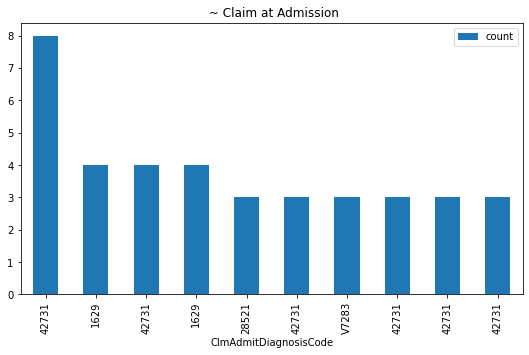

In [99]:
x = final_df.groupby(['BeneID','ClmAdmitDiagnosisCode'])['PotentialFraud']\
        .value_counts()\
        .reset_index(name='count')\
        .rename(columns={'index':'BeneID'})\
        .nlargest(10,'count')\
        .plot(kind='bar', x = 'ClmAdmitDiagnosisCode', title=' ~ Claim at Admission', figsize=(9,5))
plt.savefig('save_as_a_png.png')
x

In [ ]:
final_df['ClaimStartDt'] = pd.to_datetime(final_df['ClaimStartDt'])

In [ ]:
final_df['month'] = final_df['ClaimStartDt'].dt.month
final_df['day'] = final_df['ClaimStartDt'].dt.day
final_df['weekday'] = final_df['ClaimStartDt'].dt.day_name()

In [ ]:
sns.barplot(x='month', y ='monthly_count', data=monthly_visit, hue='in_patient')